<a href="https://colab.research.google.com/github/prajwal-suresh13/image_colorization/blob/master/image_colorization_cyclegan_training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#hide
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
#hide
%load_ext autoreload
%autoreload 2

%matplotlib inline
%cd /content/gdrive/My Drive/Colab Notebooks

/content/gdrive/My Drive/Colab Notebooks


In [ ]:
#Clone this repo to import core modules for training loop, optimizers, cyclegan models, loss functions etc 
!git clone https://github.com/prajwal-suresh13/dl_lib.git

In [ ]:
#hide
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sun Sep 25 11:30:48 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from dl_lib.core.all import *
from dl_lib.cyclegan.all import *

In [ ]:
norm_zero_point_five = partial(normalize_channel, mean=tensor([0.5,0.5,0.5]).cuda(), std = tensor([0.5,0.5,0.5]).cuda())

# Convert Video to frames 

Custom dataset of 3000 images each for B/W and color images are created from 2 public domain movies. (TheGoldRush-1925 and Charade-1963)

A subset of 100 images each can be found [here](https://github.com/prajwal-suresh13/image_colorization/tree/master/data)

To create own dataset from videos, video2frame function can be used

```
video2frame(source_video_path, destination_folder, no_of_images, start_times_secs, crop)

source_video_path : Video from which frames needs to be captured and saved
destination_folder : Folder where the captured frames needs to be stored
no_of_images : Number of images to be captured from video
start_times_secs : Time in sec from where frames needs to be captured. default=None
crop : 4 values (x,width,y, height) needs to be provided if frame needs to be cropped before saving. default=None 
```

In [ ]:
video_path='/content/gdrive/My Drive/Charade(1963).mp4'
dest='/content/gdrive/My Drive/Colab Notebooks/image_colorization/data/color_frames'
print(os.path.exists(video_path),os.path.exists(dest))

True False


In [3]:
# video2frame(video_path,dest,3000,start_time_secs=4*60)

In [ ]:
video_path='/content/gdrive/My Drive/TheGoldRush1925.mp4'
dest='/content/gdrive/My Drive/Colab Notebooks/image_colorization/data/bw_frames'
print(os.path.exists(video_path),os.path.exists(dest))

True False


In [4]:
# video2frame(video_path,dest,3000,start_time_secs=5*60,crop=(0,480,110,740))

In [ ]:
len(Path('/content/gdrive/My Drive/Colab Notebooks/image_colorization/data/color_frames').ls())

3000

# CycleGAN Training

- The images are progressively resized from 64x64 to 512x512 while training CycleGAN model.
- Model is trained for total 60 epochs, 17 hours
    - 20 epochs - 64x64 - 40 min,
    - 20 epochs - 128x128 - 80 min,
    - 20 epochs - 256x256 - 300 min (5hrs),
    - 10 epochs - 512x512 - 600 min (10 hrs)

In [ ]:
domainA = './image_colorization/data/bw_frames'
domainB = './image_colorization/data/color_frames'

##64x64

In [ ]:
train_dl = get_dataloader(domainA, domainB, batch_size=8 , image_size=64)
data = DataBunch(train_dl,[])

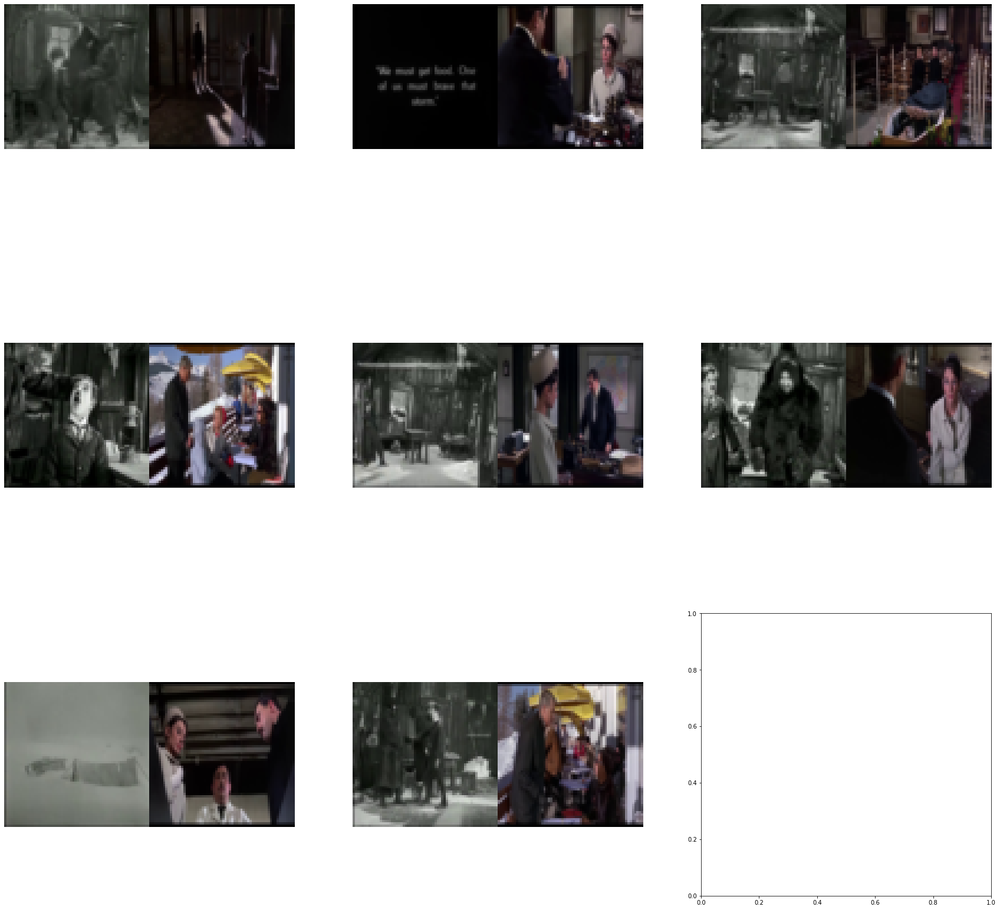

In [ ]:
show_img2img_batch(data.train_dl)

In [ ]:
learn = cyclegan_learner(data, norm=norm_zero_point_five, lr_find=True, perc_scale=0.1)
learn.fit(5)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:136: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and will be removed in 0.15. Please use keyword parameter(s) instead.
  f"Using {sequence_to_str(tuple(keyword_only_kwargs.keys()), separate_last='and ')} as positional "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


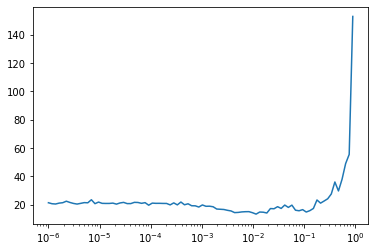

In [ ]:
learn.recorder.plot()

In [ ]:
# del learn
import gc
gc.collect()

44

In [ ]:
sched = combine_scheds([0.5,0.5],[sched_no(5e-4, 5e-4), sched_cos(5e-4, 5e-6)])

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:136: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and will be removed in 0.15. Please use keyword parameter(s) instead.
  f"Using {sequence_to_str(tuple(keyword_only_kwargs.keys()), separate_last='and ')} as positional "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

epoch,train_loss,Id_Loss,Gen_Loss,Cyc_Loss,DA_Loss,DB_Loss,Perc_loss,time
0,12.588319,1.425206,1.896491,2.755005,0.040255,0.018815,4.259261,03:33
1,9.131796,1.207186,1.244915,2.140877,0.067574,0.162868,3.674810,02:10
2,7.241547,0.827072,1.007242,1.668081,0.134867,0.132641,3.399437,02:09
3,6.562346,0.718660,1.123644,1.457503,0.107012,0.117108,3.127999,02:08
4,6.305973,0.669189,1.191215,1.358249,0.093563,0.104601,2.994390,02:08
5,6.180787,0.625435,1.252180,1.291665,0.082779,0.096843,2.880880,02:08
6,6.000616,0.605279,1.286104,1.256317,0.079334,0.092461,2.825267,02:08
7,5.894031,0.581031,1.332642,1.218686,0.076491,0.085447,2.727303,02:07
8,5.787934,0.564156,1.351513,1.192168,0.072348,0.082082,2.678184,02:08
9,5.764725,0.562468,1.373159,1.183107,0.072365,0.082276,2.658034,02:08


/content/gdrive/My Drive/Colab Notebooks/dl_lib/core/optimizers.py:104: UserWarning: This overload of addcmul_ is deprecated:
	addcmul_(Number value, Tensor tensor1, Tensor tensor2)
Consider using one of the following signatures instead:
	addcmul_(Tensor tensor1, Tensor tensor2, *, Number value) (Triggered internally at  ../torch/csrc/utils/python_arg_parser.cpp:1174.)
  state['sqr_grad_avg'].mul_(sqr_mom).addcmul_(state['sqr_mom_damp'], p.grad.data, p.grad.data)


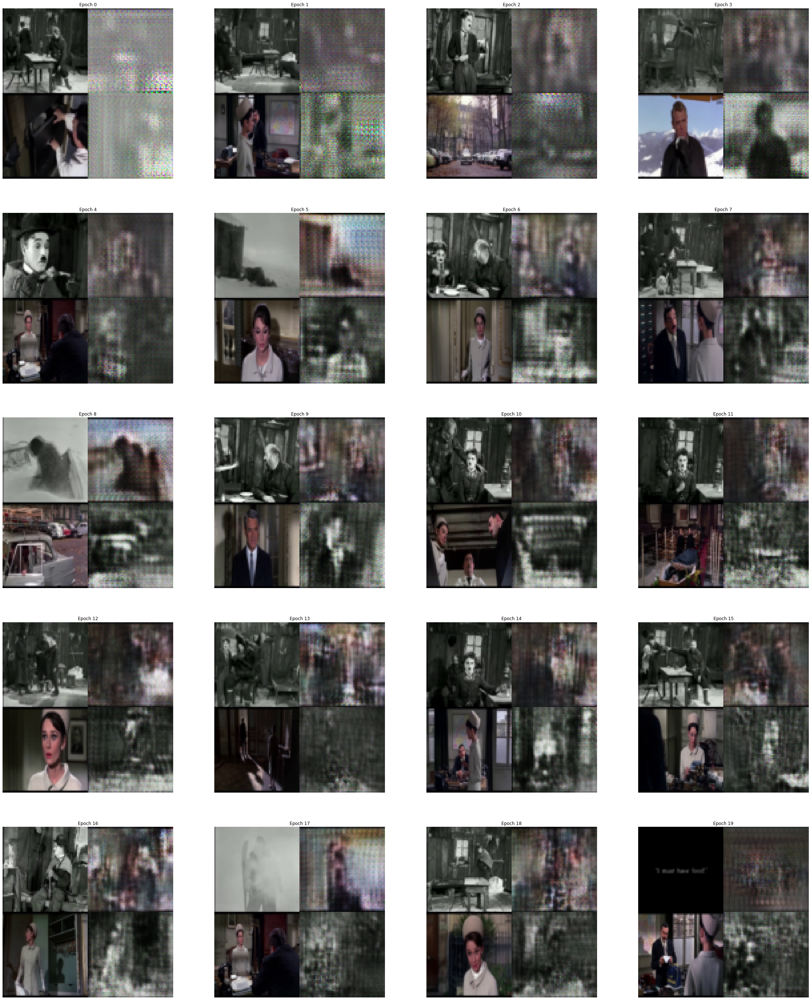

In [ ]:
learn = cyclegan_learner(data, norm=norm_zero_point_five, perc_scale=0.1)
learn.fit(20, cbs=[ParamScheduler('lr',sched), SaveCycleGANModelCallback('./image_colorization/model/cyclegan_models/64', interval=5)])

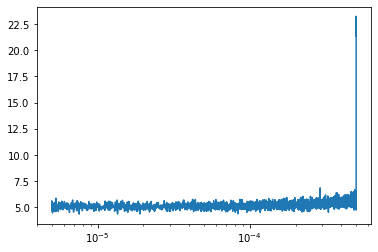

In [ ]:
learn.recorder.plot()

##128x128

In [ ]:
sched = combine_scheds([0.5,0.5],[sched_no(1e-3, 1e-3), sched_cos(1e-3, 1e-5)])

epoch,train_loss,Id_Loss,Gen_Loss,Cyc_Loss,DA_Loss,DB_Loss,Perc_loss,time
0,4.868095,0.529165,1.207276,1.176041,0.140868,0.129003,1.795237,04:29
1,4.386199,0.461214,1.142196,1.035666,0.138137,0.127299,1.682439,04:28
2,4.307040,0.440644,1.224791,0.996604,0.125836,0.104133,1.634481,04:29
3,4.163432,0.405538,1.218503,0.964568,0.121534,0.120174,1.563961,04:29
4,4.075899,0.388781,1.178970,0.886093,0.123603,0.119948,1.511818,04:29
5,3.933401,0.386318,1.170966,0.871703,0.124093,0.116798,1.492278,04:29
6,3.872895,0.370155,1.180499,0.852991,0.117434,0.117065,1.459575,04:30
7,3.794153,0.357136,1.163552,0.824858,0.115298,0.120685,1.408493,04:30
8,3.740674,0.346569,1.173295,0.819055,0.111955,0.126665,1.390834,04:30
9,3.678221,0.336390,1.182697,0.808822,0.106155,0.125357,1.362855,04:30


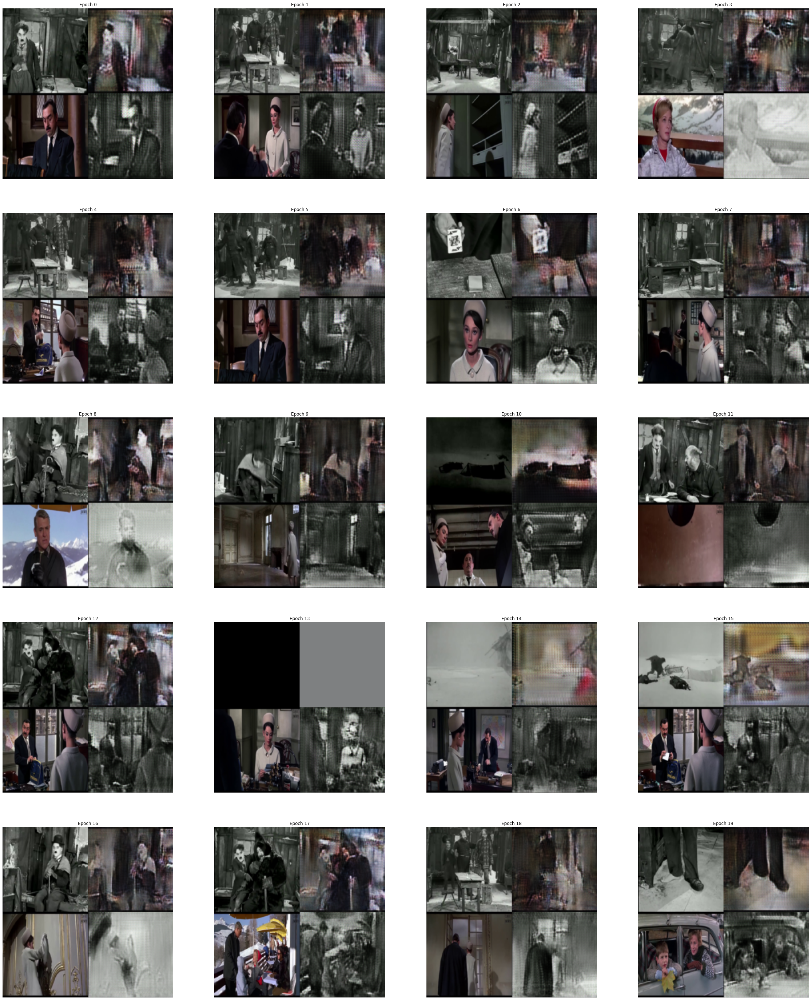

In [ ]:
learn.data.train_dl =get_dataloader(domainA, domainB, batch_size=8 , image_size=128)
learn.fit(20, cbs=[ParamScheduler('lr',sched), SaveCycleGANModelCallback('./image_colorization/model/cyclegan_models/128', interval=5)])

## 256x256

In [ ]:
data = DataBunch(get_dataloader(domainA, domainB, batch_size=4 , image_size=256),[])
learn = cyclegan_learner(data, norm=norm_zero_point_five, perc_scale=0.1, lr_find=True)
learn.fit(5, cbs=LoadCycleGANModelCallback('./image_colorization/model/cyclegan_models/128/19.pth',from_start=True))

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:136: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and will be removed in 0.15. Please use keyword parameter(s) instead.
  f"Using {sequence_to_str(tuple(keyword_only_kwargs.keys()), separate_last='and ')} as positional "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

/content/gdrive/My Drive/Colab Notebooks/dl_lib/core/optimizers.py:104: UserWarning: This overload of addcmul_ is deprecated:
	addcmul_(Number value, Tensor tensor1, Tensor tensor2)
Consider using one of the following signatures instead:
	addcmul_(Tensor tensor1, Tensor tensor2, *, Number value) (Triggered internally at  ../torch/csrc/utils/python_arg_parser.cpp:1174.)
  state['sqr_grad_avg'].mul_(sqr_mom).addcmul_(state['sqr_mom_damp'], p.grad.data, p.grad.data)


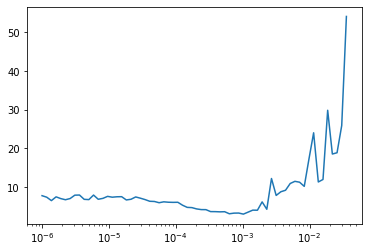

In [ ]:
learn.recorder.plot()

In [ ]:
# learn=None
import gc
gc.collect()
torch.cuda.empty_cache()

In [ ]:
sched = combine_scheds([0.5,0.5],[sched_no(8e-4, 8e-4), sched_cos(8e-4, 8e-6)])

epoch,train_loss,Id_Loss,Gen_Loss,Cyc_Loss,DA_Loss,DB_Loss,Perc_loss,time
0,2.916542,0.279596,0.942882,0.686427,0.182412,0.174796,0.842276,15:27
1,2.727552,0.271554,0.992413,0.652692,0.155746,0.160815,0.810300,15:26
2,2.671613,0.250730,1.010917,0.611174,0.153861,0.158941,0.786207,15:26
3,2.645458,0.243670,1.018431,0.608916,0.151593,0.152919,0.771989,15:26
4,2.616457,0.236876,1.011517,0.600641,0.162665,0.145899,0.754063,15:26
5,2.596721,0.231814,1.012247,0.590806,0.156845,0.146486,0.751147,15:26
6,2.562172,0.221905,1.029545,0.557231,0.147114,0.149974,0.725298,15:26
7,2.550796,0.222371,1.055641,0.580618,0.147331,0.144455,0.735097,15:26
8,2.517734,0.204179,1.054922,0.527749,0.143854,0.141852,0.703678,15:27
9,2.534625,0.210949,1.062589,0.536993,0.145255,0.143083,0.700047,15:28


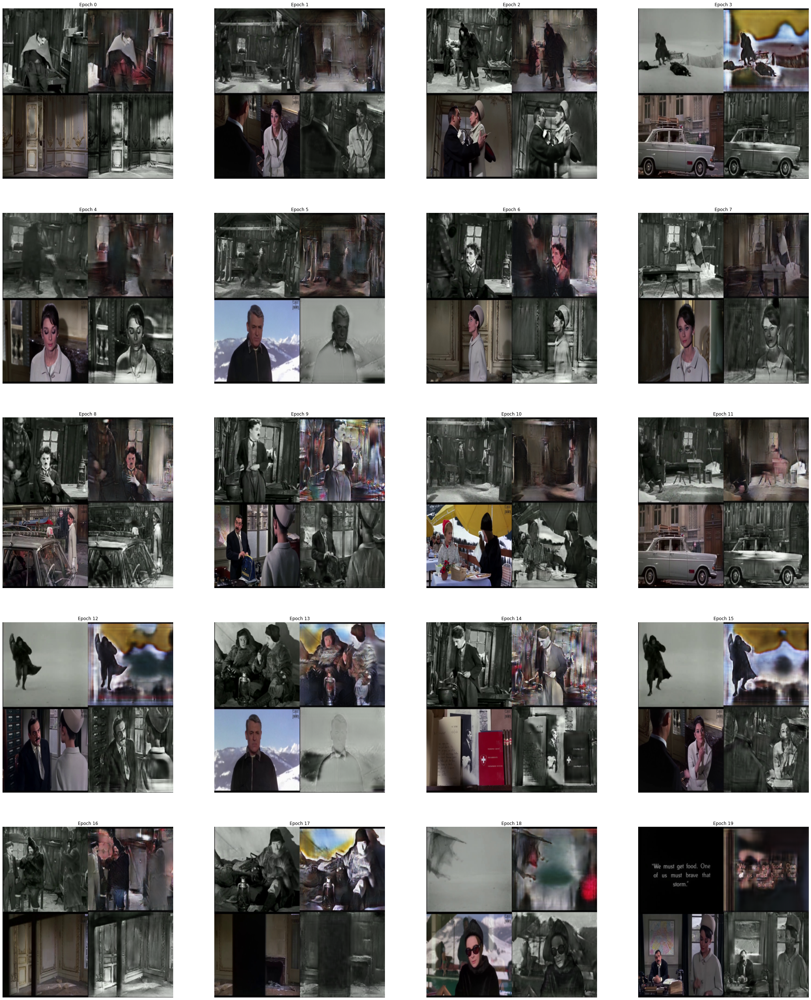

In [ ]:
learn = cyclegan_learner(data, norm=norm_zero_point_five, perc_scale=0.1)
learn.fit(20, cbs=[ParamScheduler('lr', sched),LoadCycleGANModelCallback('./image_colorization/model/cyclegan_models/128/19.pth',from_start=True),
                   SaveCycleGANModelCallback('./image_colorization/model/cyclegan_models/256', interval=5)])

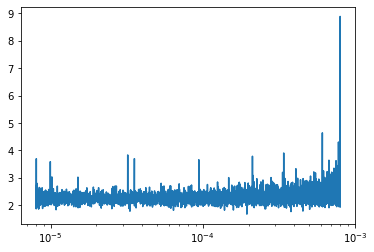

In [ ]:
learn.recorder.plot()

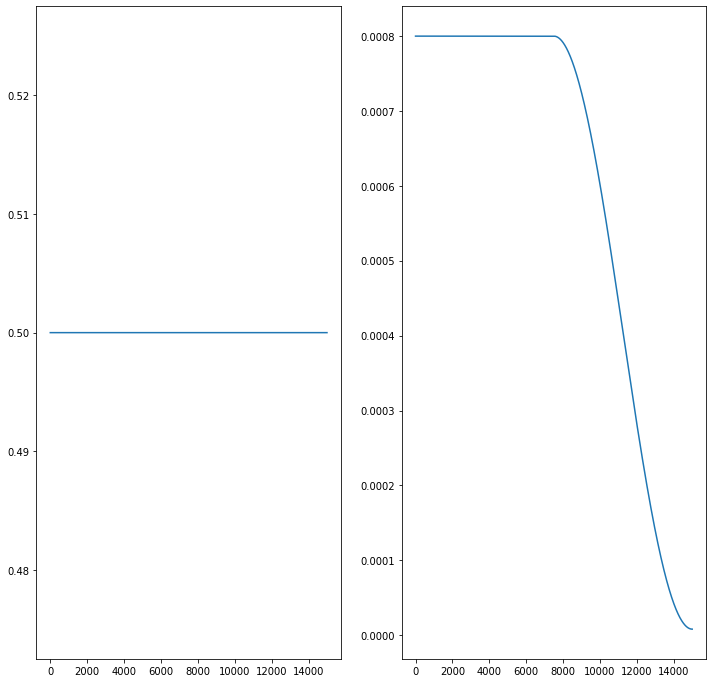

In [ ]:
learn.recorder.plot_hypers()

In [ ]:
# learn=None
import gc
gc.collect()
torch.cuda.empty_cache()

## 512x512

In [ ]:
data = DataBunch(get_dataloader(domainA, domainB, batch_size=1 , image_size=512),[])
learn = cyclegan_learner(data, norm=norm_zero_point_five, perc_scale=0.1, lr_find=True)
learn.fit(5, cbs=LoadCycleGANModelCallback('./image_colorization/model/cyclegan_models/256/19.pth',from_start=True))

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:136: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and will be removed in 0.15. Please use keyword parameter(s) instead.
  f"Using {sequence_to_str(tuple(keyword_only_kwargs.keys()), separate_last='and ')} as positional "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

/content/gdrive/My Drive/Colab Notebooks/dl_lib/core/optimizers.py:104: UserWarning: This overload of addcmul_ is deprecated:
	addcmul_(Number value, Tensor tensor1, Tensor tensor2)
Consider using one of the following signatures instead:
	addcmul_(Tensor tensor1, Tensor tensor2, *, Number value) (Triggered internally at  ../torch/csrc/utils/python_arg_parser.cpp:1174.)
  state['sqr_grad_avg'].mul_(sqr_mom).addcmul_(state['sqr_mom_damp'], p.grad.data, p.grad.data)


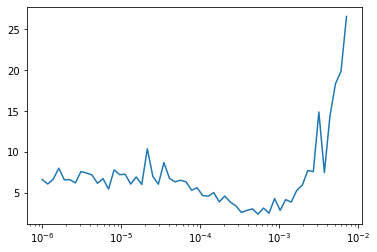

In [ ]:
learn.recorder.plot()

In [ ]:
# learn=None
import gc
gc.collect()
torch.cuda.empty_cache()

In [ ]:
sched = combine_scheds([0.5,0.5],[sched_no(8e-4, 8e-4), sched_cos(8e-4, 8e-6)])

In [ ]:
data = DataBunch(get_dataloader(domainA, domainB, batch_size= 1, image_size=512),[])

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:136: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and will be removed in 0.15. Please use keyword parameter(s) instead.
  f"Using {sequence_to_str(tuple(keyword_only_kwargs.keys()), separate_last='and ')} as positional "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

epoch,train_loss,Id_Loss,Gen_Loss,Cyc_Loss,DA_Loss,DB_Loss,Perc_loss,time
0,2.525210,0.237284,0.916132,0.638551,0.214484,0.170524,0.515202,1:01:11
1,2.295411,0.219092,0.976172,0.558750,0.194782,0.163124,0.482755,1:00:33
2,2.222821,0.206915,0.993898,0.562341,0.184752,0.142644,0.476292,1:00:34
3,2.088532,0.156115,1.047457,0.388176,0.165982,0.108028,0.421644,1:00:41
4,1.890169,0.139218,0.990790,0.336625,0.175378,0.116519,0.413254,1:00:40


/content/gdrive/My Drive/Colab Notebooks/dl_lib/core/optimizers.py:104: UserWarning: This overload of addcmul_ is deprecated:
	addcmul_(Number value, Tensor tensor1, Tensor tensor2)
Consider using one of the following signatures instead:
	addcmul_(Tensor tensor1, Tensor tensor2, *, Number value) (Triggered internally at  ../torch/csrc/utils/python_arg_parser.cpp:1174.)
  state['sqr_grad_avg'].mul_(sqr_mom).addcmul_(state['sqr_mom_damp'], p.grad.data, p.grad.data)


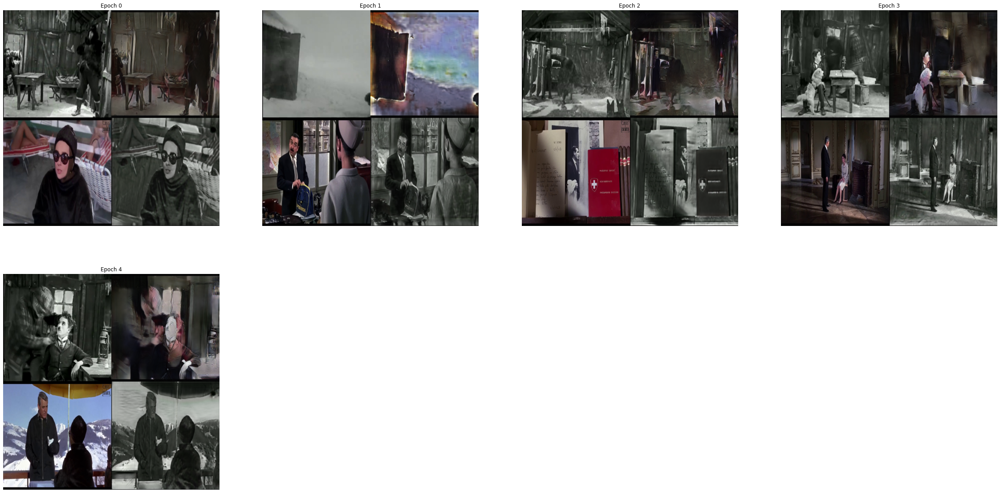

In [ ]:
learn = cyclegan_learner(data, norm=norm_zero_point_five, perc_scale=0.1)
learn.fit(5, cbs=[ParamScheduler('lr', sched),LoadCycleGANModelCallback('./image_colorization/model/cyclegan_models/256/19.pth',from_start=True),
                   SaveCycleGANModelCallback('./image_colorization/model/cyclegan_models/512', interval=1)])

In [ ]:
# learn=None
import gc
gc.collect()
torch.cuda.empty_cache()

In [ ]:
learn = cyclegan_learner(data, norm=norm_zero_point_five, perc_scale=0.1, lr_find=True)
learn.fit(5, cbs=LoadCycleGANModelCallback('./image_colorization/model/cyclegan_models/512/4.pth',from_start=True))

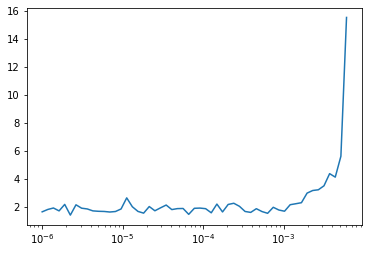

In [ ]:
learn.recorder.plot()

In [ ]:
# learn=None
import gc
gc.collect()
torch.cuda.empty_cache()

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:136: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and will be removed in 0.15. Please use keyword parameter(s) instead.
  f"Using {sequence_to_str(tuple(keyword_only_kwargs.keys()), separate_last='and ')} as positional "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,Id_Loss,Gen_Loss,Cyc_Loss,DA_Loss,DB_Loss,Perc_loss,time
0,1.879810,0.141893,0.976694,0.351010,0.171100,0.120794,0.412741,1:00:37
1,1.873970,0.131387,0.938459,0.329621,0.176579,0.130498,0.401886,1:00:38
2,1.879983,0.133412,0.980828,0.333790,0.175926,0.118981,0.416327,1:00:36
3,1.859891,0.139398,0.990006,0.328640,0.171875,0.118105,0.410247,1:00:38
4,1.836156,0.136123,0.994276,0.309454,0.164859,0.125456,0.402727,1:00:45


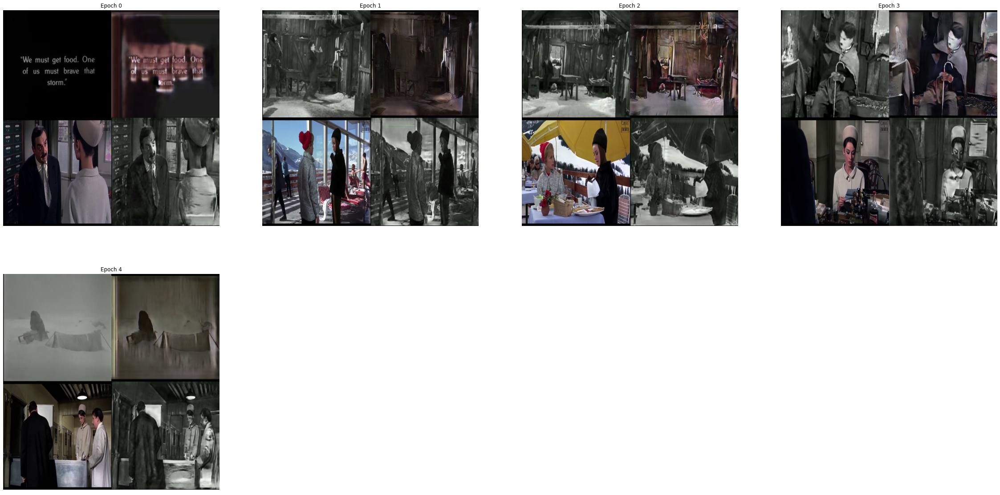

In [ ]:
sched = combine_scheds([0.5,0.5],[sched_no(1e-4, 1e-4), sched_cos(1e-4, 1e-6)])
learn = cyclegan_learner(data, norm=norm_zero_point_five, perc_scale=0.1)
learn.fit(5, cbs=[ParamScheduler('lr', sched),LoadCycleGANModelCallback('./image_colorization/model/cyclegan_models/512/4.pth',from_start=True),
                   SaveCycleGANModelCallback('./image_colorization/model/cyclegan_models/512_1', interval=1)]) 